In [1]:
from tqdm import tnrange, tqdm_notebook
from datetime import datetime, timedelta
import pandas
import numpy

# Import plot making tools
from plotly.offline import init_notebook_mode, iplot
init_notebook_mode(connected=False)
import cufflinks as cf
cf.go_offline()

In [2]:
df = pandas.read_csv('results/5min_houses_pv_052014_052015_v0001.csv',
                     parse_dates=[0], index_col=[0])

# normalize pv data [0, 1]
df['pv_coef'] = df['pv_w/m2'] / 1000

# pick a PV size, and calculate PV production
installed_pv_kW = 40
df['pv_kW'] = df['pv_coef'] * installed_pv_kW

# find the intersection of both curves representing the localy consummed PV energy
df['self_kW'] =  df['pv_kW'] - df['houses_kW']
df['self_kW'] = df.apply(lambda x: x['pv_kW'] if x['self_kW'] < 0 else x['houses_kW'], axis=1)

# Do not change dataframe "df" later on..

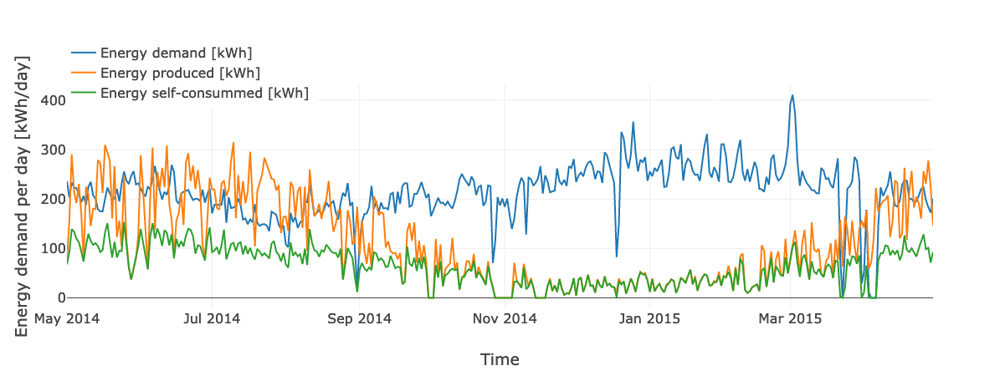

In [3]:
fig = {
    'data': [

        {'x': df.groupby(pandas.Grouper(freq='D')).sum().index.tolist(),
         'y': df.groupby(pandas.Grouper(freq='D'))['houses_kW'].sum()  * 5 / 60,
         'mode': 'lines',
         'line': {'width' : 2},
         'name': 'Energy demand [kWh]'},
        
        {'x': df.groupby(pandas.Grouper(freq='D')).sum().index.tolist(),
         'y': df.groupby(pandas.Grouper(freq='D'))['pv_kW'].sum()  * 5 / 60,
         'mode': 'lines',
         'line': {'width' : 2},
         'name': 'Energy produced [kWh]'},

        {'x': df.groupby(pandas.Grouper(freq='D')).sum().index.tolist(),
         'y': df.groupby(pandas.Grouper(freq='D'))['self_kW'].sum()  * 5 / 60,
         'mode': 'lines',
         'line': {'width' : 2},
         'name': 'Energy self-consummed [kWh]'},
    ]
,
    'layout': {
        'xaxis': {'title': 'Time'},
        'yaxis': {'title': 'Energy demand per day [kWh/day]'},
        'showlegend': True,
        'legend': {'x': 0, 'y': 1.2},
        'font': {'size': 16}
    }
}
iplot(fig)

In [5]:
pv_capacities = list(range(0, 70))
yearly_net_energy = [((df['pv_coef'] * j).sum() * 100 /
                      df['houses_kW'].sum()) 
                     for j in pv_capacities]
yearly_self_produced = []
tmp = df.copy()
for pv_capacity in tqdm_notebook(pv_capacities, desc='Progress'):
    tmp['pv_kW'] = tmp['pv_coef'] * pv_capacity
    tmp['self_kW'] =  tmp['pv_kW'] - tmp['houses_kW']
    tmp['self_kW'] = tmp.apply(lambda x: x['pv_kW'] if x['self_kW'] < 0 else x['houses_kW'], axis=1)
    yearly_self_produced.append(tmp['self_kW'].sum() * 100 / df['houses_kW'].sum())

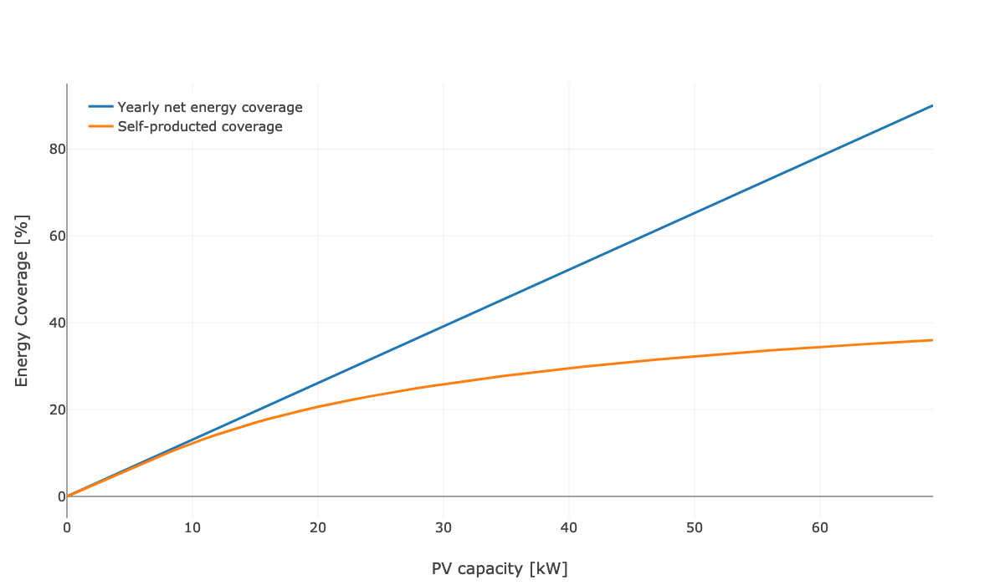

In [6]:
fig = {
    'data': [

        {'x': pv_capacities,
         'y': yearly_net_energy,
         'mode': 'lines',
         'line': {'width' : 3},
         'name': 'Yearly net energy coverage'},
        
        {'x': pv_capacities,
         'y': yearly_self_produced,
         'mode': 'lines',
         'line': {'width' : 3},
         'name': 'Self-producted coverage'},
    ]
,
    'layout': {
        'xaxis': {'title': 'PV capacity [kW]'},
        'yaxis': {'title': 'Energy Coverage [%]'},
        'showlegend': True,
        'legend': {'x': 0.02, 'y': .98},
        'font': {'size': 16},
        'width': 800,
        'height': 700,
    }
}
iplot(fig)

# Implement low tech coordination mechanism
- rule n°1: charge battery if PV is producing more than 15kW else do nothing,
- rule n°2: discharge battery if house is consumming energy and power output equal house demand,
- rule n°3: the battery is limited by a capacity and a power output.

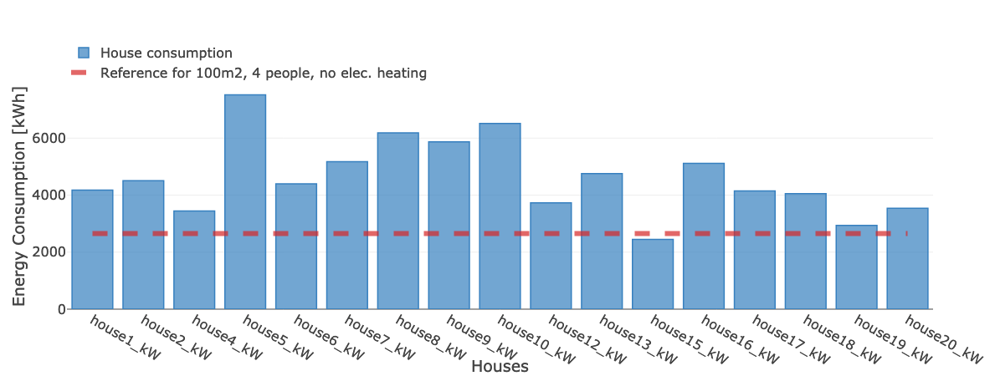

In [6]:
tmp = df[[k for k in df.columns if 'dish'
          not in k and 'houses' not in k
          and 'pv' not in k and 'self' not in k]]
fig = {
    'data': [

        {'x': tmp.columns,
         'y': tmp.sum() * 5 / 60,
         'type': 'bar',
         'marker': {'color': 'rgba(55, 128, 191, 0.7)',
                    'line': {'width': 1.5,
                             'color': 'rgba(55, 128, 191, 1.0)'}},
         'name': 'House consumption'},

        {'x': tmp.columns,
         'y': [2650] * len(tmp.columns),
         'mode': 'lines',
         'opacity': 0.7,
         'line': {'width' : 6, 'color': '#d62728',
                  'dash': 'dash'},
         'name': 'Reference for 100m2, 4 people, no elec. heating'},
    ]
,
    'layout': {
        'xaxis': {'title': 'Houses', 'dtick': 1},
        'yaxis': {'title': 'Energy Consumption [kWh]'},
        'barmode': 'group',
        'showlegend': True,
        'legend': {'x': 0, 'y': 1.2},
        'font': {'size': 16}
    }
}
iplot(fig)

Half of the houses with the larger energy demand have 2kW batteries with varying storage capacity.

In [7]:
tmp = df[[k for k in df.columns if 'dish'
          not in k and 'houses' not in k
          and 'pv' not in k and 'self' not in k]]
houses_with_battery = (tmp.sum() * 5 / 60).sort_values(ascending=False).index.tolist()[:10]
print(houses_with_battery)

['house5_kW', 'house10_kW', 'house8_kW', 'house9_kW', 'house7_kW', 'house16_kW', 'house13_kW', 'house2_kW', 'house6_kW', 'house1_kW']


In [8]:

def low_tech_controller(battery_size=2, battery_charge_power=1,
                        battery_discharge_power=1):
    """
    battery_size = 2 # kWh
    battery_charge_power = 1  # kW
    battery_discharge_power = 1  # kW
    """
    timestep = 5
    nin = 0.9
    nout = 0.9

    # Temporary vector to be faster
    battery_kwh = {a[:7] + 'kWh':[battery_size / 2] for a in houses_with_battery}
    battery_kw = {a[:7] + 'kW':[] for a in houses_with_battery}
    it = -1

    start = datetime.now() 
    for t in tqdm_notebook(df.index, desc='Progress'):  # Do not reach the end but T-1
        it += 1
        produce = df.loc[t, 'pv_kW'] > 0
        produce_gt_10kw = df.loc[t, 'pv_kW'] > 15
        for index, house in enumerate(houses_with_battery):
            housenb = house[:7]

            # Charge if PV produce
            if produce and produce_gt_10kw:
                # Battery is not full
                if battery_kwh[housenb + 'kWh'][it] < battery_size:
                    # Power is minimum of maxP and remaining empty space
                    battery_kw[housenb + 'kW'].append(
                        min(battery_charge_power,
                            (battery_size - battery_kwh[housenb + 'kWh'][it]) * 60 / timestep / nin))
                    battery_kwh[housenb + 'kWh'].append(battery_kwh[housenb + 'kWh'][it] +
                                              battery_kw[housenb + 'kW'][it] * timestep / 60 * nin)
                else:
                    battery_kw[housenb + 'kW'].append(0)
                    battery_kwh[housenb + 'kWh'].append(battery_size)

            # Do not charge PV output is low
            elif produce:
                battery_kw[housenb + 'kW'].append(0)
                battery_kwh[housenb + 'kWh'].append(battery_kwh[housenb + 'kWh'][it])       

            # Discharge the battery
            else:
                # Battery is not empty
                if battery_kwh[housenb + 'kWh'][it] > 0:
                    # Power is maximum of minP and remaining energy
                    battery_kw[housenb + 'kW'].append(
                        max([
                            -df.loc[t, house],
                            -battery_discharge_power,
                            -battery_kwh[housenb + 'kWh'][it] * 60 / timestep * nout]))
                    battery_kwh[housenb + 'kWh'].append(battery_kwh[housenb + 'kWh'][it] +
                                              battery_kw[housenb + 'kW'][it] * timestep / 60 / nout)
                else:
                    battery_kw[housenb + 'kW'].append(0)
                    battery_kwh[housenb + 'kWh'].append(0)

    # Remove last time for battery energies
    for index, house in enumerate(houses_with_battery):
        del battery_kwh[house[:7] + 'kWh'][-1]

    # Merge back to a DataFrame
    battery = pandas.DataFrame(
        index=df.index,
        data={**battery_kwh, **battery_kw})

    print('Time elapsed (hh:mm:ss.ms) {}'.format(
        datetime.now() - start))
    return battery

In [11]:
battery = low_tech_controller(battery_size=4, battery_charge_power=1, battery_discharge_power=2)


Time elapsed (hh:mm:ss.ms) 0:00:06.418751


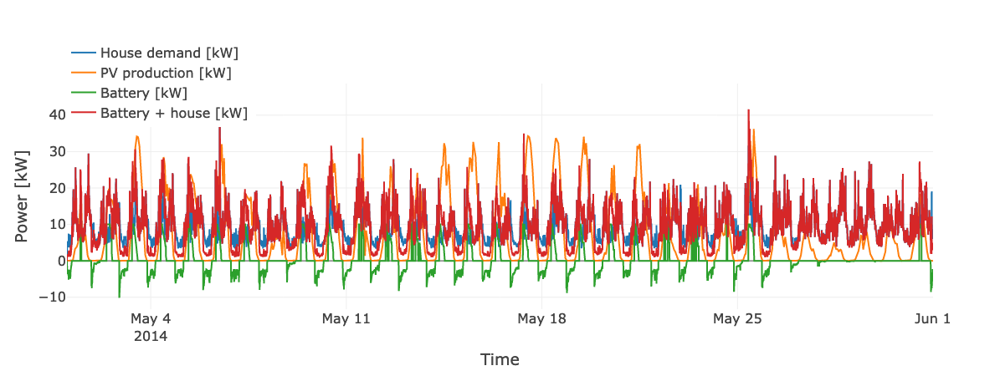

In [12]:
fig = {
    'data': [

        {'x': df.loc['2014-05-01 00:00:00':'2014-06-01 00:00:00', :].index,
         'y': df.loc['2014-05-01 00:00:00':'2014-06-01 00:00:00', 'houses_kW'],
         'mode': 'lines',
         'line': {'width' : 2},
         'name': 'House demand [kW]'},
        
        {'x': df.loc['2014-05-01 00:00:00':'2014-06-01 00:00:00', :].index,
         'y': df.loc['2014-05-01 00:00:00':'2014-06-01 00:00:00', 'pv_kW'],
         'mode': 'lines',
         'line': {'width' : 2},
         'name': 'PV production [kW]'},

        {'x': battery.loc['2014-05-01 00:00:00':'2014-06-01 00:00:00', :].index,
         'y': battery.loc['2014-05-01 00:00:00':'2014-06-01 00:00:00',
                          [a[:7] + 'kW' for a in houses_with_battery]].sum(axis=1),
         'mode': 'lines',
         'line': {'width' : 2},
         'name': 'Battery [kW]'},
        
        {'x': battery.loc['2014-05-01 00:00:00':'2014-06-01 00:00:00', :].index,
         'y': (battery.loc['2014-05-01 00:00:00':'2014-06-01 00:00:00',
                          [a[:7] + 'kW' for a in houses_with_battery]].sum(axis=1) +
              df.loc['2014-05-01 00:00:00':'2014-06-01 00:00:00', 'houses_kW']),
         'mode': 'lines',
         'line': {'width' : 2},
         'name': 'Battery + house [kW]'},
    ]
,
    'layout': {
        'xaxis': {'title': 'Time'},
        'yaxis': {'title': 'Power [kW]'},
        'showlegend': True,
        'legend': {'x': 0, 'y': 1.2},
        'font': {'size': 16}
    }
}
iplot(fig)

In [11]:
battery = low_tech_controller(battery_size=9, battery_charge_power=1, battery_discharge_power=1)


Time elapsed (hh:mm:ss.ms) 0:00:06.771882


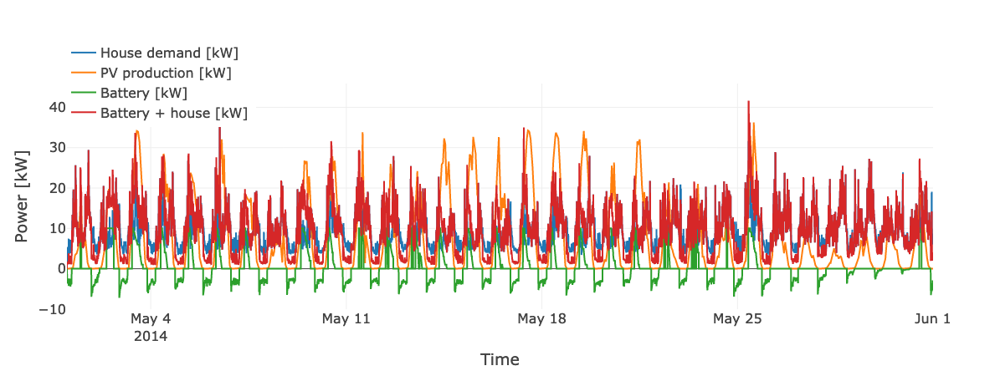

In [12]:
fig = {
    'data': [

        {'x': df.loc['2014-05-01 00:00:00':'2014-06-01 00:00:00', :].index,
         'y': df.loc['2014-05-01 00:00:00':'2014-06-01 00:00:00', 'houses_kW'],
         'mode': 'lines',
         'line': {'width' : 2},
         'name': 'House demand [kW]'},
        
        {'x': df.loc['2014-05-01 00:00:00':'2014-06-01 00:00:00', :].index,
         'y': df.loc['2014-05-01 00:00:00':'2014-06-01 00:00:00', 'pv_kW'],
         'mode': 'lines',
         'line': {'width' : 2},
         'name': 'PV production [kW]'},

        {'x': battery.loc['2014-05-01 00:00:00':'2014-06-01 00:00:00', :].index,
         'y': battery.loc['2014-05-01 00:00:00':'2014-06-01 00:00:00',
                          [a[:7] + 'kW' for a in houses_with_battery]].sum(axis=1),
         'mode': 'lines',
         'line': {'width' : 2},
         'name': 'Battery [kW]'},
        
        {'x': battery.loc['2014-05-01 00:00:00':'2014-06-01 00:00:00', :].index,
         'y': (battery.loc['2014-05-01 00:00:00':'2014-06-01 00:00:00',
                          [a[:7] + 'kW' for a in houses_with_battery]].sum(axis=1) +
              df.loc['2014-05-01 00:00:00':'2014-06-01 00:00:00', 'houses_kW']),
         'mode': 'lines',
         'line': {'width' : 2},
         'name': 'Battery + house [kW]'},
    ]
,
    'layout': {
        'xaxis': {'title': 'Time'},
        'yaxis': {'title': 'Power [kW]'},
        'showlegend': True,
        'legend': {'x': 0, 'y': 1.2},
        'font': {'size': 16}
    }
}
iplot(fig)

In [13]:
battery_sizing = list(range(1, 10))
yearly_self_produced_lowtech = []
for batt_kWh in battery_sizing:
    battery = low_tech_controller(battery_size=batt_kWh,
                                  battery_charge_power=1,
                                  battery_discharge_power=1)
    tmp = df.copy()
    tmp['houses_kW'] += battery[[a[:7] + 'kW' for a in houses_with_battery]].sum(axis=1)
    tmp['self_kW'] = tmp['pv_kW'] - tmp['houses_kW']
    tmp['self_kW'] = tmp.apply(lambda x: x['pv_kW'] if x['self_kW'] < 0 else x['houses_kW'], axis=1)
    yearly_self_produced_lowtech.append(tmp['self_kW'].sum() * 100 / df['houses_kW'].sum())


Time elapsed (hh:mm:ss.ms) 0:00:05.207392



Time elapsed (hh:mm:ss.ms) 0:00:05.361573



Time elapsed (hh:mm:ss.ms) 0:00:06.484623



Time elapsed (hh:mm:ss.ms) 0:00:06.301037



Time elapsed (hh:mm:ss.ms) 0:00:06.422512



Time elapsed (hh:mm:ss.ms) 0:00:06.785522



Time elapsed (hh:mm:ss.ms) 0:00:06.615103



Time elapsed (hh:mm:ss.ms) 0:00:07.214061



Time elapsed (hh:mm:ss.ms) 0:00:06.534188


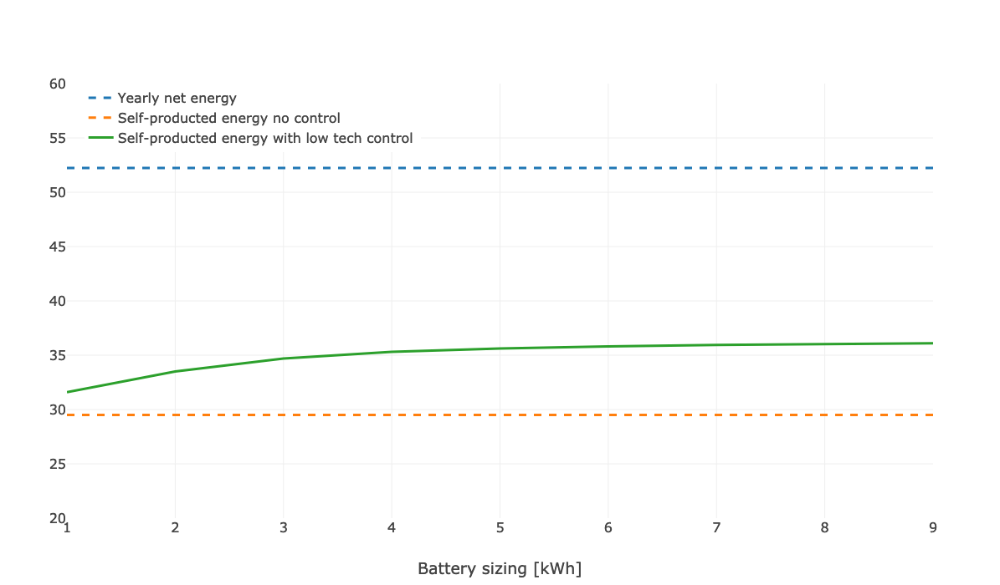

In [14]:
fig = {
    'data': [

        {'x': battery_sizing,
         'y': [yearly_net_energy[
                    pv_capacities.index(installed_pv_kW)]] * len(battery_sizing),
         'mode': 'lines',
         'line': {'width' : 3, 'dash': 'dash'},
         'name': 'Yearly net energy'},
        
        {'x': battery_sizing,
         'y': [yearly_self_produced[
                    pv_capacities.index(installed_pv_kW)]] * len(battery_sizing),
         'mode': 'lines',
         'line': {'width' : 3, 'dash': 'dash'},
         'name': 'Self-producted energy no control'},

        {'x': battery_sizing,
         'y': yearly_self_produced_lowtech,
         'mode': 'lines',
         'line': {'width' : 3},
         'name': 'Self-producted energy with low tech control'},
    ]
,
    'layout': {
        'xaxis': {'title': 'Battery sizing [kWh]'},
        'yaxis': {'title': 'Energy Coverage [%]'},
        'showlegend': True,
        'legend': {'x': 0.02, 'y': 1.0},
        'font': {'size': 16},
        'width': 800,
        'height': 700,
        'yaxis': {'range':[20, 60]}
    }
}
iplot(fig)

# Predictive optimization with an energy pool

In [69]:
from pyomo.opt import SolverFactory
from pyomo.environ import *
import pandas

def maximize_self_consumption(uncontrollable, dfbatteries,
                              dfshapeables, dfdeferrables,
                              timestep, solver='gurobi',
                              verbose=False, solver_path=None,
                              timelimit=5*60):
    """
    Version v001 Minimize \sum_{t}^T peak^+ - peak^-
    Optimize batteries, shapeable and deferrable loads to maximize
    collective self-consumption.
    Inputs:
        - uncontrollable (DataFrame): uncontrollable load demand
        - dfbatteries (DataFrame): order book
        - dfshapeables (DataFrame): order book
        - dfdeferrables (DataFrame): order book
        - timestep (float): one is equivalent to hourly timestep
    Outputs:
        - demandshape
        - batteryin
        - batteryout
        - batteryenergy
        - demanddeferr
        - deferrschedule
        - demand_controllable
        - community_import
        - total community_import
        - peakhigh
        - peaklow
    """
    # Inputs
    horizon = uncontrollable.index.tolist()
    demand_uncontrollable = uncontrollable.p.to_list()
    batteries = dfbatteries.index.tolist()
#     shapeables = dfshapeables.index.tolist()
#     deferrables = dfdeferrables.index.tolist()
    m = ConcreteModel()

    ###################################################### Set
    m.horizon = Set(initialize=horizon, ordered=True)
    last = m.horizon.last()
    m.batteries = Set(initialize=batteries, ordered=True)
#     m.shapeables = Set(initialize=shapeables, ordered=True)
#     m.deferrables = Set(initialize=deferrables, ordered=True)

    ##################################################### Var
    m.community_import = Var(m.horizon, domain=Reals)
    m.demand_controllable = Var(m.horizon, domain=Reals)
#     m.peakhigh = Var(domain=Reals)
#     m.peaklow = Var(domain=Reals)

    # Equipment specifics
#     m.demandshape = Var(m.horizon, m.shapeables, domain=Reals)
    m.batteryin = Var(m.horizon, m.batteries, domain=Reals)
    m.batteryout = Var(m.horizon, m.batteries, domain=Reals)
    m.batteryenergy = Var(m.horizon, m.batteries, domain=Reals)
#     m.demanddeferr = Var(m.horizon, m.deferrables, domain=Reals)
#     m.deferrschedule = Var(m.horizon, m.deferrables,
#                            domain=NonNegativeIntegers)

#     #################################################### Rules
#     # --------------------------------------------------------
#     # ------------------shapeable load------------------------
#     # --------------------------------------------------------
#     # The power bounds are defined by the load characteristics
#     def r_shape_min_power(m, t, s):
#         return (m.demandshape[t, s] >= 0)

#     def r_shape_max_power(m, t, s):
#         return (m.demandshape[t, s] <=
#                 dfshapeables.loc[s, 'max_kw'])

#     # At the end the energy asked by the load is satisfied
#     def r_shape_energy(m, s):
#         return (sum(m.demandshape[i, s] for i in m.horizon) ==
#                 dfshapeables.loc[s, 'end_kwh'])

#     # If we are outside of startby - endby, we enforce zero power
#     def r_shape_timebounds(m, t, s):
#         if t < dfshapeables.loc[s, 'startby']:
#             return m.demandshape[t, s] == 0
#         if t > dfshapeables.loc[s, 'endby']:
#             return m.demandshape[t, s] == 0
#         else:
#             return Constraint.Skip

    # --------------------------------------------------------
    # ---------------------Battery----------------------------
    # --------------------------------------------------------
    # The power bounds are defined by the battery characteristics
    def r_battery_min_powerin(m, t, b):
        return (m.batteryin[t, b] >= 0)

    def r_battery_max_powerin(m, t, b):
        return (m.batteryin[t, b] <= dfbatteries.loc[b, 'max_kw'])

    def r_battery_min_powerout(m, t, b):
        return (m.batteryout[t, b] >= 0)

    def r_battery_max_powerout(m, t, b):
        return (m.batteryout[t, b] <= dfbatteries.loc[b, 'min_kw'])

    # Define the SOC considering charge/discharge efficiency
    def r_battery_energy(m, t, b):
        if t == 0:
            return m.batteryenergy[t, b] == dfbatteries.loc[b, 'initial_kwh']
        else:
            return (m.batteryenergy[t, b] ==
                    m.batteryenergy[t-1, b] +
                    m.batteryin[t, b] * timestep * dfbatteries.loc[b, 'eta']
                    - m.batteryout[t, b] * timestep / dfbatteries.loc[b, 'eta'])
                    # 0.25 pour un quart d'heure

    # Energy bound during operation
    def r_battery_min_energy(m, t, b):
        return (m.batteryenergy[t, b] >= 0)

    def r_battery_max_energy(m, t, b):
        return (m.batteryenergy[t, b] <= dfbatteries.loc[b, 'max_kwh'])

    # Energy status at the end
    def r_battery_end_energy(m, b):
        return (m.batteryenergy[last, b] >= dfbatteries.loc[b, 'end_kwh'])

    # If we are outside of startby - endby, we enforce no operation
    def r_batteryin_timebounds(m, t, b):
        if t < dfbatteries.loc[b, 'startby']:
            return (m.batteryin[t, b] == 0)
        if t > dfbatteries.loc[b, 'endby']:
            return (m.batteryin[t, b] == 0)
        else:
            return Constraint.Skip

    def r_batteryout_timebounds(m, t, b):
        if t < dfbatteries.loc[b, 'startby']:
            return (m.batteryout[t, b] == 0)
        if t > dfbatteries.loc[b, 'endby']:
            return (m.batteryout[t, b] == 0)
        else:
            return Constraint.Skip

#     # --------------------------------------------------------
#     # ---------------------Deferrable-------------------------
#     # --------------------------------------------------------
#     # Convolution of the power profile (time horizon L)
#     # and the scheduler (time horizon T)
#     def r_deferrable_schedule(m, t, d):
#         return (m.demanddeferr[t, d] ==
#                 sum(m.deferrschedule[t - k, d] * dfdeferrables.loc[d, 'profile_kw'][k]
#                    for k in range(0, min(dfdeferrables.loc[d, 'duration'], t + 1))))

#     # We can only schedule a load once within the time horizon
#     def r_deferrable_schedule_sum(m, d):
#         return (sum(m.deferrschedule[i, d] for i in m.horizon) == 1)

#     # If we are outside of startby - endby, we enforce no operation
#     def r_deferrable_timebounds(m, t, d):
#         if t < dfdeferrables.loc[d, 'startby']:
#             return (m.demanddeferr[t, d] == 0)
#         if t > dfdeferrables.loc[d, 'endby']:
#             return (m.demanddeferr[t, d] == 0)
#         else:
#             return Constraint.Skip

    # --------------------------------------------------------
    # ---------------------Helper-----------------------------
    # --------------------------------------------------------
#     # Useless step which seems to be necessary
#     def r_demand_total(m, t):
#         return (m.demand_controllable[t] ==
#                 sum(m.demandshape[t, s] for s in m.shapeables) +
#                 sum(m.batteryin[t, b] - m.batteryout[t, b] for b in m.batteries) +
#                 sum(m.demanddeferr[t, d] for d in m.deferrables))
    
    def r_demand_total(m, t):
        return (m.demand_controllable[t] ==
                sum(m.batteryin[t, b] - m.batteryout[t, b] for b in m.batteries))

#     # Limit maximum peak
#     def r_peak_high(m, t):
#         return (m.demand_controllable[t] + demand_uncontrollable[t]
#                 <= m.peakhigh)

#     # Stop constraint at 0
#     def r_peak_high_zero(m, t):
#         return (0 <= m.peakhigh)

#     # Limit minimum peak
#     def r_peak_low(m, t):
#         return (m.peaklow
#                 <= m.demand_controllable[t] + demand_uncontrollable[t])

#     # Stop constraint at 0
#     def r_peak_low_zero(m, t):
#         return (m.peaklow <= 0)

    # Community import (by definition above zero)
    def community_import_zero(m, t):
        return (m.community_import[t] >= 0)

    # Community import (by definition above zero)
    def community_import(m, t):
        return (m.community_import[t] >=
                m.demand_controllable[t] + demand_uncontrollable[t])
    
#     # Shapeable
#     m.r1 = Constraint(m.horizon, m.shapeables, rule=r_shape_min_power)
#     m.r2 = Constraint(m.horizon, m.shapeables, rule=r_shape_max_power)
#     m.r3 = Constraint(m.shapeables, rule=r_shape_energy)
#     m.r4 = Constraint(m.horizon, m.shapeables, rule=r_shape_timebounds)
    # Battery
    m.r5 = Constraint(m.horizon, m.batteries, rule=r_battery_min_powerin)
    m.r6 = Constraint(m.horizon, m.batteries, rule=r_battery_max_powerin)
    m.r7 = Constraint(m.horizon, m.batteries, rule=r_battery_min_powerout)
    m.r8 = Constraint(m.horizon, m.batteries, rule=r_battery_max_powerout)
    m.r9 = Constraint(m.horizon, m.batteries, rule=r_battery_energy)
    m.r10 = Constraint(m.horizon, m.batteries, rule=r_battery_min_energy)
    m.r11 = Constraint(m.horizon, m.batteries, rule=r_battery_max_energy)
    m.r12 = Constraint(m.batteries, rule=r_battery_end_energy)
    m.r13 = Constraint(m.horizon, m.batteries, rule=r_batteryin_timebounds)
    m.r14 = Constraint(m.horizon, m.batteries, rule=r_batteryout_timebounds)
#     # Deferrable
#     m.r16 = Constraint(m.horizon, m.deferrables, rule=r_deferrable_schedule)
#     m.r17 = Constraint(m.deferrables, rule=r_deferrable_schedule_sum)
#     m.r18 = Constraint(m.horizon, m.deferrables, rule=r_deferrable_timebounds)
    # Helper
    m.r15 = Constraint(m.horizon, rule=r_demand_total)
#     m.r19 = Constraint(m.horizon, rule=r_peak_high)
#     m.r20 = Constraint(m.horizon, rule=r_peak_low)
#     m.r21 = Constraint(m.horizon, rule=r_peak_low_zero)
#     m.r22 = Constraint(m.horizon, rule=r_peak_high_zero)
    m.r23 = Constraint(m.horizon, rule=community_import_zero)
    m.r24 = Constraint(m.horizon, rule=community_import)
    
    ##################################################### Objective function
    # Linear objective function
    def objective_function(m):
        return sum(m.community_import[i] for i in m.horizon)
    m.objective = Objective(rule=objective_function, sense=minimize)

    #################################################### Run
    # Solve optimization problem
    with SolverFactory(solver, executable=solver_path) as opt:
        if solver in 'glpk':
            opt.options['tmlim'] = timelimit
            results = opt.solve(m, tee=verbose)
        if solver in 'gurobi':
            opt.options['TimeLimit'] = timelimit
            results = opt.solve(m, tee=verbose)
        if solver in 'cbc':
            results = opt.solve(m, timelimit=timelimit, tee=verbose)
#         else:
#             results = opt.solve(m, tee=verbose)

    if verbose:
        print(results)

    #################################################### Results
    # A Dictionnary contains all the results
    results = {}
#     keys = ['demandshape', 'batteryin',
#             'batteryout', 'batteryenergy',
#             'demanddeferr', 'deferrschedule']
    keys = ['batteryin',
            'batteryout', 'batteryenergy']

    for key in keys:
        try:
            tmp = pandas.DataFrame(index=['none'],
                    data=getattr(m, key).get_values())
            tmp = tmp.transpose()
            tmp = tmp.unstack(level=1)
            tmp.columns = tmp.columns.levels[1]
            results[key] = tmp.copy()
        except:
            results[key] = None

    # demand_controllable
    results['demand_controllable'] = list(
        m.demand_controllable.get_values().values())

    # community_import
    results['community_import'] = [ max(0, a + b)
                                  for a, b in zip(
                                  demand_uncontrollable,
                                  results['demand_controllable'])]

#     # High peak
#     results['peakhigh'] = m.peakhigh.get_values()[None]

#     # Low peak
#     results['peaklow'] = m.peaklow.get_values()[None]

    # Total import from the community
    results['total_community_import'] = sum(
        results['community_import'] ) * timestep
    return results


# Make it work for a week

In [70]:
# Uncontrollable demand
uncontrollable = df.copy()
uncontrollable['p'] = uncontrollable['houses_kW'] - uncontrollable['pv_kW']
uncontrollable['index'] = list(range(0, len(uncontrollable)))
uncontrollable = uncontrollable.loc['2014-05-01 00:00:00':'2014-05-08 00:00:00', ['index', 'p']]
uncontrollable.set_index('index', inplace=True)

# Order book for Shapeable
data = {'startby': [],
        'endby': [],
        'max_kw': [],
        'end_kwh': []}
dfshapeables = pandas.DataFrame(data=data)


# Order book for Deferrable
data = {'startby': [],
        'endby': [],
        'duration': [],
        'profile_kw': []}
dfdeferrables = pandas.DataFrame(data=data)

# Order book for battery
data = {'startby': [0] * len(houses_with_battery),
        'endby': [len(uncontrollable)] * len(houses_with_battery),
        'min_kw': [1] * len(houses_with_battery),
        'max_kw': [1] * len(houses_with_battery),
        'max_kwh': [2] * len(houses_with_battery),
        'initial_kwh': [1] * len(houses_with_battery),
        'end_kwh': [1] * len(houses_with_battery),
        'eta': [0.9] * len(houses_with_battery)}
dfbatteries = pandas.DataFrame(data=data)
dfbatteries.head()

,startby,endby,min_kw,max_kw,max_kwh,initial_kwh,end_kwh,eta
0,0,2017,1,1,2,1,1,0.9
1,0,2017,1,1,2,1,1,0.9
2,0,2017,1,1,2,1,1,0.9
3,0,2017,1,1,2,1,1,0.9
4,0,2017,1,1,2,1,1,0.9


In [72]:
start = datetime.now() 
glpk = maximize_self_consumption(uncontrollable, dfbatteries,
                          dfshapeables, dfdeferrables,
                          timestep=5/60, solver='glpk',
                          solver_path=None, verbose=False)
print('Time elapsed (hh:mm:ss.ms) {}'.format(
    datetime.now() - start))
print('community_import=' +
      str(int(glpk['total_community_import'])) + 'kWh')

Time elapsed (hh:mm:ss.ms) 0:00:28.293000
community_import=641kWh


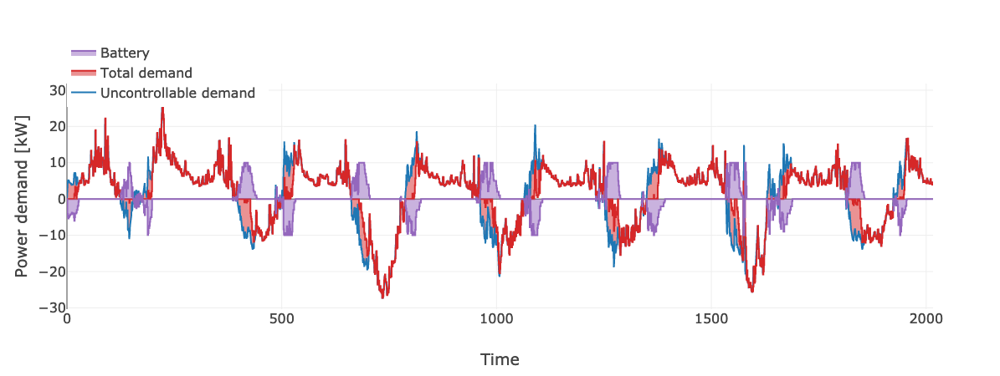

In [75]:
horizon = uncontrollable.index.tolist()
fig = {
    'data': [

        {'x': horizon,
         'y': uncontrollable.p.to_list(),
         'mode': 'lines',
         'line': {'width' : 2, 'color': '#1f77b4'},
         'name': 'Uncontrollable demand '},

        {'x': horizon,
         'y': [a + b for a, b in zip(uncontrollable.p.to_list(),
                                     glpk['demand_controllable'])],
         'mode': 'lines',
         'fill': 'tonexty',
         'line': {'width' : 2, 'color': '#d62728'},
         'line_shape':'hv',
         'name': 'Total demand'},
        
        {'x': horizon,
         'y': [a - b for a, b in
               zip(glpk['batteryin'].sum(axis=1),
                   glpk['batteryout'].sum(axis=1))],
         'mode': 'lines',
         'line': {'width' : 2, 'color': '#9467bd'},
         'fill': 'tozeroy',
         'line_shape':'hv',
         'name': 'Battery'},
    ]
,
    'layout': {
        'xaxis': {'title': 'Time'},
        'yaxis': {'title': 'Power demand [kW]'},
        'showlegend': True,
        'legend': {'x': 0, 'y': 1.2},
        'font': {'size': 16}
    }
}
iplot(fig)

In [73]:
df_glpk = pandas.DataFrame(
    index=df.loc['2014-05-01 00:00:00':'2014-05-08 00:00:00', :].index,
    data={'battery_kW': glpk['demand_controllable']})
df_glpk.head()

,battery_kW
2014-05-01 00:00:00,0.000000
2014-05-01 00:05:00,-4.111067
2014-05-01 00:10:00,-4.917280
2014-05-01 00:15:00,-5.353947
2014-05-01 00:20:00,-4.822667


In [74]:
df_glpk.tail()

,battery_kW
2014-05-07 23:40:00,0.0
2014-05-07 23:45:00,0.0
2014-05-07 23:50:00,0.0
2014-05-07 23:55:00,0.0
2014-05-08 00:00:00,0.0


# Make it work for a year

In [76]:
start = datetime.now() 
df_glpk = pandas.DataFrame()
periods = pandas.date_range(start='2014-05-01 00:00:00',
                            end='2015-04-30 23:55:00', periods=40).round('5T')

for index in tqdm_notebook(range(0, len(periods[:-1])), desc='Progress'):
    # Uncontrollable demand
    uncontrollable = df.copy()
    uncontrollable = uncontrollable.loc[periods[index]:periods[index+1], :]
    uncontrollable['p'] = uncontrollable['houses_kW'] - uncontrollable['pv_kW']
    uncontrollable['index'] = list(range(0, len(uncontrollable)))
    uncontrollable.set_index('index', inplace=True)
    uncontrollable = uncontrollable[['p']]

    # Order book for Shapeable
    data = {'startby': [],
            'endby': [],
            'max_kw': [],
            'end_kwh': []}
    dfshapeables = pandas.DataFrame(data=data)


    # Order book for Deferrable
    data = {'startby': [],
            'endby': [],
            'duration': [],
            'profile_kw': []}
    dfdeferrables = pandas.DataFrame(data=data)

    # Order book for battery
    data = {'startby': [0] * len(houses_with_battery),
            'endby': [len(uncontrollable)] * len(houses_with_battery),
            'min_kw': [1] * len(houses_with_battery),
            'max_kw': [1] * len(houses_with_battery),
            'max_kwh': [2] * len(houses_with_battery),
            'initial_kwh': [1] * len(houses_with_battery),
            'end_kwh': [1] * len(houses_with_battery),
            'eta': [0.9] * len(houses_with_battery)}
    dfbatteries = pandas.DataFrame(data=data)


    glpk = maximize_self_consumption(uncontrollable, dfbatteries,
                              dfshapeables, dfdeferrables,
                              timestep=5/60, solver='glpk',
                              solver_path=None, verbose=False)
    tmp = pandas.DataFrame(
            index=df.loc[periods[index]:periods[index+1], :].index,
            data={'battery_kW': glpk['demand_controllable']})
    df_glpk = pandas.concat([df_glpk, tmp], axis=0)


print('Time elapsed (hh:mm:ss.ms) {}'.format(
    datetime.now() - start))

Time elapsed (hh:mm:ss.ms) 0:25:19.088676


In [86]:
# Result for 2kWh
tmp = df.copy()
tmp['houses_kW'] += df_glpk['battery_kW'].loc[~df_glpk.index.duplicated(keep='first')]
tmp['self_kW'] = tmp['pv_kW'] - tmp['houses_kW']
tmp['self_kW'] = tmp.apply(lambda x: x['pv_kW'] if x['self_kW'] < 0 else x['houses_kW'], axis=1)
result = tmp['self_kW'].sum() * 100 / df['houses_kW'].sum()
print('Result for 2kWh battery and predictive controller: ')
print(result)

Result for 2kWh battery and predictive controller: 
35.341802826693915


# Make it work for multiple years

In [87]:
start = datetime.now() 
large_glpk = []
yearly_self_produced_predicitive = []
periods = pandas.date_range(start='2014-05-01 00:00:00',
                            end='2015-04-30 23:55:00', periods=40).round('5T')

for batt_size in [1, 3, 5, 7, 9]:
    print('Battery size: ' + str(batt_size) + ' kWh')
    df_glpk = pandas.DataFrame()
    for index in tqdm_notebook(range(0, len(periods[:-1])), desc='Progress'):
        # Uncontrollable demand
        uncontrollable = df.copy()
        uncontrollable = uncontrollable.loc[periods[index]:periods[index+1], :]
        uncontrollable['p'] = uncontrollable['houses_kW'] - uncontrollable['pv_kW']
        uncontrollable['index'] = list(range(0, len(uncontrollable)))
        uncontrollable.set_index('index', inplace=True)
        uncontrollable = uncontrollable[['p']]

        # Order book for Shapeable
        data = {'startby': [],
                'endby': [],
                'max_kw': [],
                'end_kwh': []}
        dfshapeables = pandas.DataFrame(data=data)


        # Order book for Deferrable
        data = {'startby': [],
                'endby': [],
                'duration': [],
                'profile_kw': []}
        dfdeferrables = pandas.DataFrame(data=data)

        # Order book for battery
        data = {'startby': [0] * len(houses_with_battery),
                'endby': [len(uncontrollable)] * len(houses_with_battery),
                'min_kw': [1] * len(houses_with_battery),
                'max_kw': [1] * len(houses_with_battery),
                'max_kwh': [batt_size] * len(houses_with_battery),
                'initial_kwh': [batt_size/2] * len(houses_with_battery),
                'end_kwh': [batt_size/2] * len(houses_with_battery),
                'eta': [0.9] * len(houses_with_battery)}
        dfbatteries = pandas.DataFrame(data=data)


        glpk = maximize_self_consumption(uncontrollable, dfbatteries,
                                  dfshapeables, dfdeferrables,
                                  timestep=5/60, solver='gurobi',
                                  solver_path=None, verbose=False)
        tmp = pandas.DataFrame(
                index=df.loc[periods[index]:periods[index+1], :].index,
                data={'battery_kW': glpk['demand_controllable']})
        df_glpk = pandas.concat([df_glpk, tmp], axis=0)
    
    # Calculate result
    tmp = df.copy()
    tmp['houses_kW'] += df_glpk['battery_kW'].loc[~df_glpk.index.duplicated(keep='first')]
    tmp['self_kW'] = tmp['pv_kW'] - tmp['houses_kW']
    tmp['self_kW'] = tmp.apply(lambda x: x['pv_kW'] if x['self_kW'] < 0 else x['houses_kW'], axis=1)
    yearly_self_produced_predicitive.append(
        tmp['self_kW'].sum() * 100 / df['houses_kW'].sum())

    # Save results to check later
    large_glpk.append(df_glpk.copy())

print('Time elapsed (hh:mm:ss.ms) {}'.format(
    datetime.now() - start))

Battery size: 1 kWh


Battery size: 3 kWh


Battery size: 5 kWh


Battery size: 7 kWh


Battery size: 9 kWh


Time elapsed (hh:mm:ss.ms) 2:02:56.955441


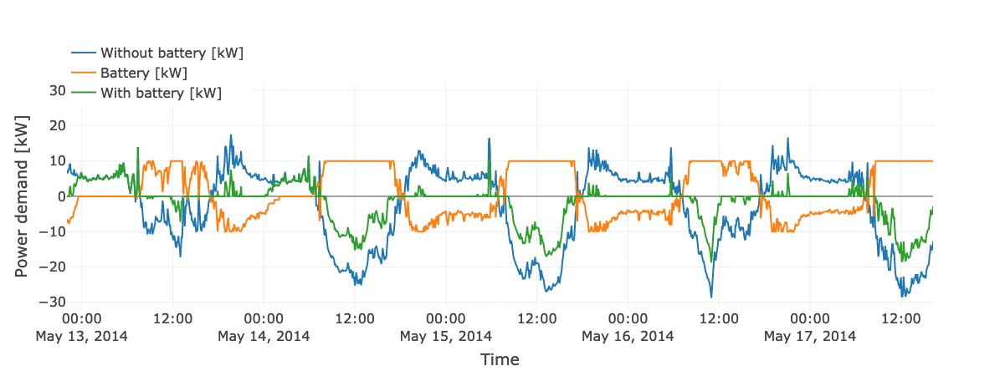

In [96]:
horizon = large_glpk[-1].loc[~large_glpk[-1].index.duplicated(keep='first')].index
fig = {
    'data': [

#         {'x': horizon,
#          'y': df.loc['2014-05-01 00:00:00':'2014-06-01 00:00:00', 'houses_kW'],
#          'mode': 'lines',
#          'line': {'width' : 2},
#          'name': 'House demand [kW]'},

#         {'x': horizon,
#          'y': df.loc['2014-05-01 00:00:00':'2014-06-01 00:00:00', 'pv_kW'],
#          'mode': 'lines',
#          'line': {'width' : 2},
#          'name': 'PV production [kW]'},

        {'x': horizon,
         'y': (df.loc['2014-05-01 00:00:00':'2014-06-01 00:00:00', 'houses_kW'] -
               df.loc['2014-05-01 00:00:00':'2014-06-01 00:00:00', 'pv_kW']),
         'mode': 'lines',
         'line': {'width' : 2},
         'name': 'Without battery [kW]'},
        
        {'x': horizon,
         'y': large_glpk[-1].loc[~large_glpk[-1].index.duplicated(keep='first')].loc[
             '2014-05-01 00:00:00':'2014-06-01 00:00:00', 'battery_kW'],
         'mode': 'lines',
         'line': {'width' : 2},
         'name': 'Battery [kW]'},

        {'x': horizon,
         'y': (large_glpk[-1].loc[~large_glpk[-1].index.duplicated(keep='first')].loc[
             '2014-05-01 00:00:00':'2014-06-01 00:00:00', 'battery_kW'] +
               df.loc['2014-05-01 00:00:00':'2014-06-01 00:00:00', 'houses_kW'] -
               df.loc['2014-05-01 00:00:00':'2014-06-01 00:00:00', 'pv_kW']),
         'mode': 'lines',
         'line': {'width' : 2},
         'name': 'With battery [kW]'},
    ]
,
    'layout': {
        'xaxis': {'title': 'Time'},
        'yaxis': {'title': 'Power demand [kW]'},
        'showlegend': True,
        'legend': {'x': 0, 'y': 1.2},
        'font': {'size': 16}
    }
}
iplot(fig)

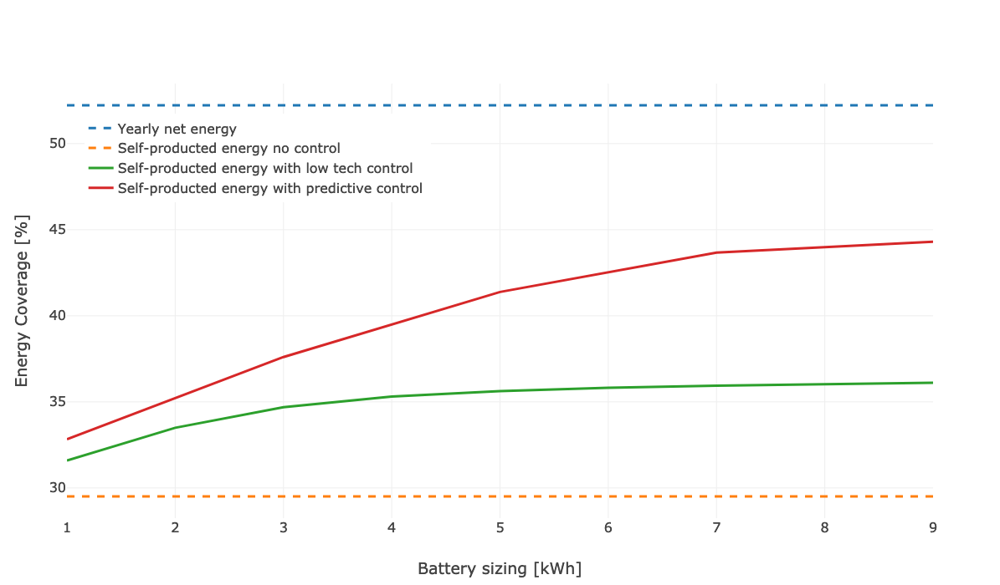

In [105]:
fig = {
    'data': [

        {'x': battery_sizing,
         'y': [yearly_net_energy[
                    pv_capacities.index(installed_pv_kW)]] * len(battery_sizing),
         'mode': 'lines',
         'line': {'width' : 3, 'dash': 'dash'},
         'name': 'Yearly net energy'},
        
        {'x': battery_sizing,
         'y': [yearly_self_produced[
                    pv_capacities.index(installed_pv_kW)]] * len(battery_sizing),
         'mode': 'lines',
         'line': {'width' : 3, 'dash': 'dash'},
         'name': 'Self-producted energy no control'},

        {'x': battery_sizing,
         'y': yearly_self_produced_lowtech,
         'mode': 'lines',
         'line': {'width' : 3},
         'name': 'Self-producted energy with low tech control'},
        
        {'x': [1, 3, 5, 7, 9],
         'y': yearly_self_produced_predicitive,
         'mode': 'lines',
         'line': {'width' : 3},
         'name': 'Self-producted energy with predictive control'},
    ]
,
    'layout': {
        'xaxis': {'title': 'Battery sizing [kWh]'},
        'yaxis': {'title': 'Energy Coverage [%]'},
        'showlegend': True,
        'legend': {'x': 0.02, 'y': 0.93},
        'font': {'size': 16},
        'width': 800,
        'height': 700,
#         'yaxis': {'range':[20, 60]},
#         'xaxis': {'range':[1, 9]}
    }
}
iplot(fig)

In [106]:
import pickle
with open('optimization_battery_sizes.obj', 'wb') as fp:
    pickle.dump(large_glpk, fp)